In [1]:
import numpy as np
import pandas as pd
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import joblib
import os
import matplotlib.pyplot as plt
import seaborn as sns



In [30]:
import pandas as pd
import numpy as np
import pickle
import streamlit as st
from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.ensemble import RandomForestClassifier

df = pd.read_csv("data.csv")
# loading in the model to predict on the data
pickle_in = open('cancer_model.pkl', 'rb')
classifier = pickle.load(pickle_in)

ModuleNotFoundError: No module named 'sklearn.ensemble.forest'

In [18]:
df = pd.read_csv("data.csv")
# df.drop(df.columns[[0,-1]], axis=1, inplace=True)

<AxesSubplot:xlabel='diagnosis'>

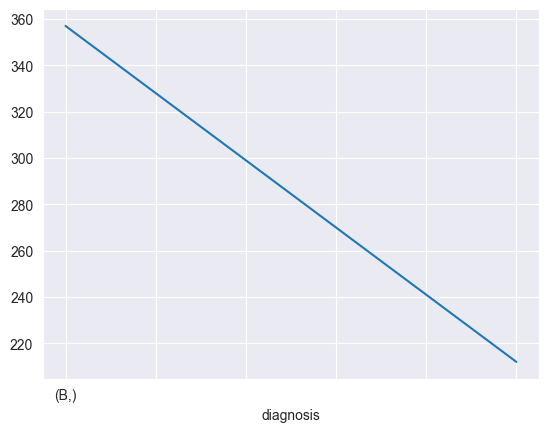

In [12]:
df[["diagnosis"]].value_counts().plot()

Text(0.5, 1.0, 'Correlation Between Features with Corr Thresgold 0.75')

<Figure size 4000x2000 with 0 Axes>

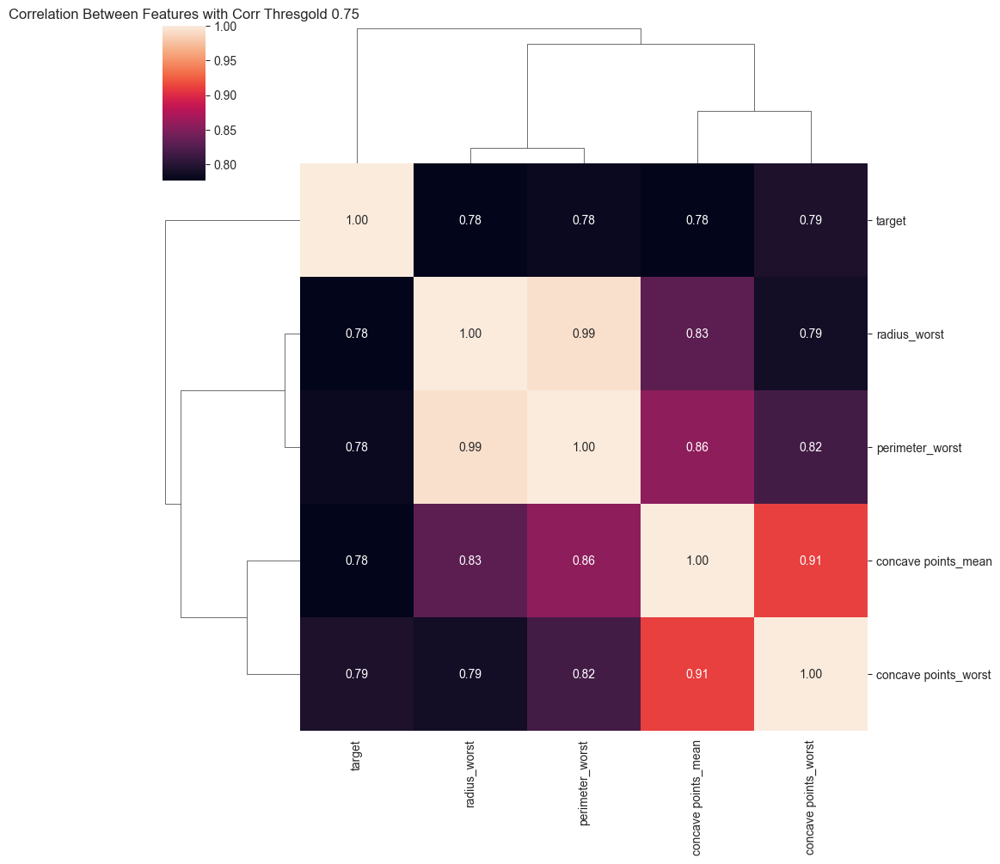

In [23]:
df = pd.read_csv("data.csv")
data = df
data = data.rename(columns = {"diagnosis" : "target"})
# 1 : M and 0 : B
data["target"] = [1 if i.strip() == "M" else 0 for i in data.target]
corr_matrix = data.corr()
threshold = 0.75
filter = np.abs(corr_matrix["target"] > threshold)
corr_features = corr_matrix.columns[filter].tolist()
fig = plt.figure(figsize=(40, 20))
sns.clustermap(data[corr_features].corr(), annot=True, fmt=".2f")
plt.title("Correlation Between Features with Corr Thresgold 0.75")


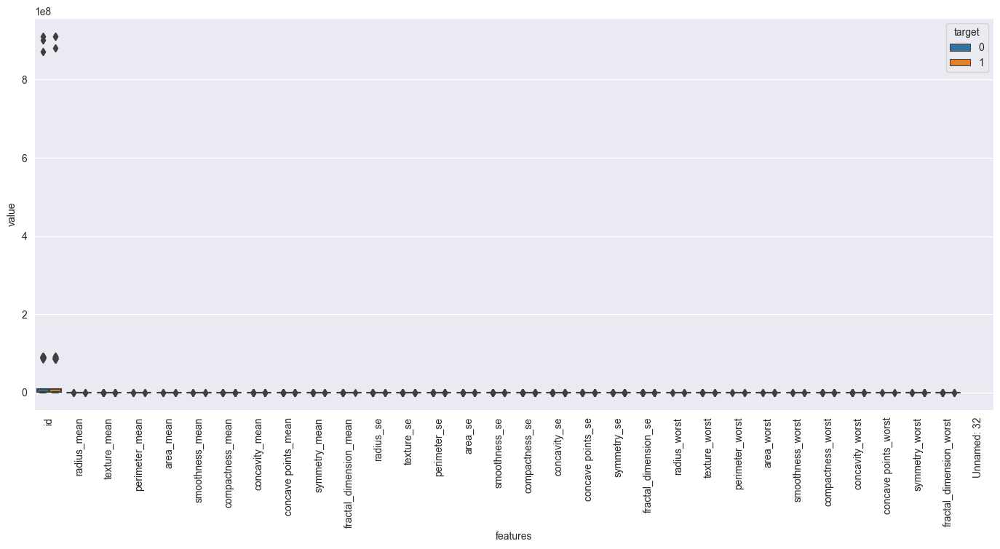

In [24]:
# Box Plot
data_melt = pd.melt(data, id_vars = "target",
                   var_name = "features",
                   value_name = "value")

plt.figure(figsize = (17,7))
sns.boxplot(x = "features", y = "value", hue = "target", data = data_melt)
plt.xticks(rotation = 90)
plt.show()

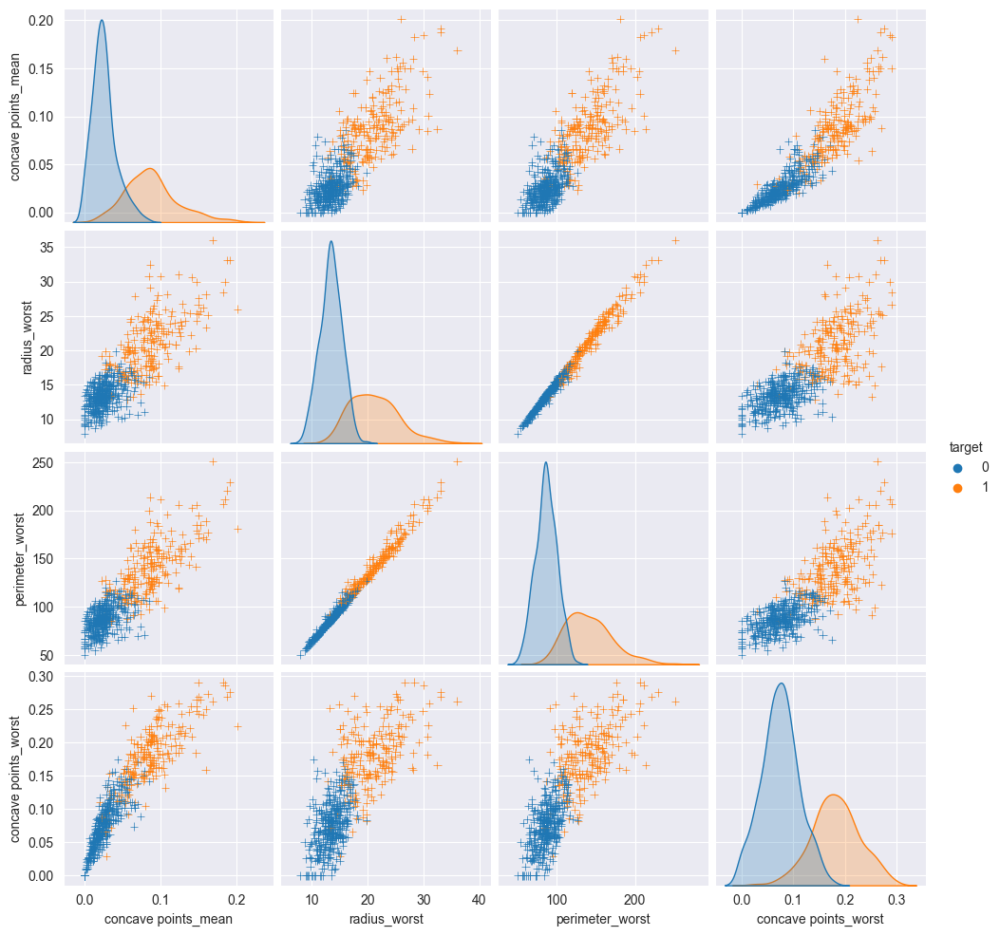

In [26]:
# Pair plot
sns.pairplot(data[corr_features], diag_kind = "kde", markers = "+", hue = "target")
plt.show()

<AxesSubplot:>

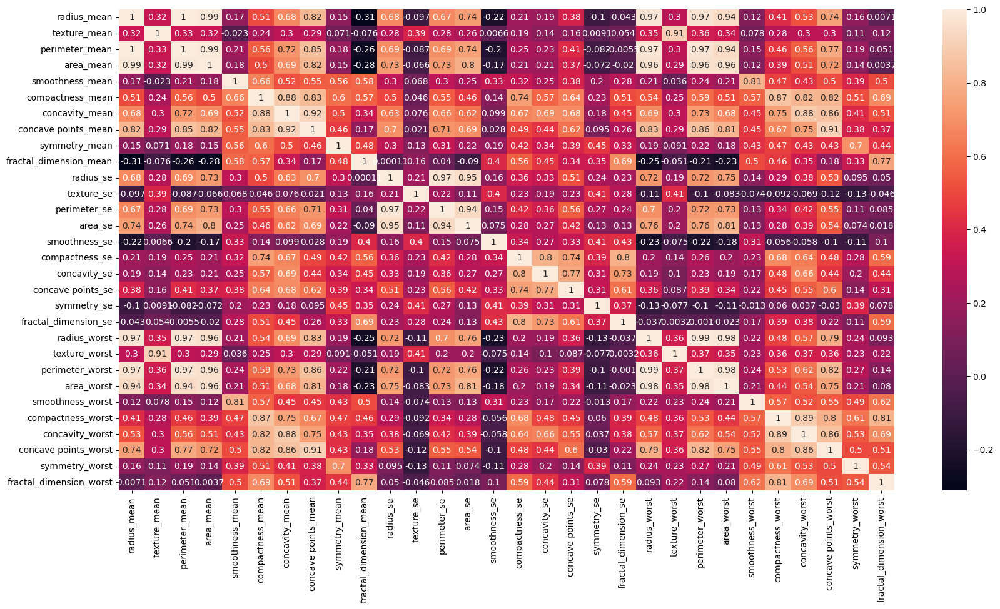

In [26]:

plt.figure(figsize=(20,10))
sns.heatmap(df.corr(), annot=True)

# Pairplot

In [28]:
sns.pairplot(df,hue='diagnosis',palette='coolwarm')

In [5]:
# Split the features data and the target
X = df.drop(['diagnosis'], axis=1)
y = df['diagnosis']

# Encoding the target value
y = np.asarray([1 if c == 'M' else 0 for c in y])
cols = ['concave points_mean','area_mean','radius_mean','perimeter_mean','concavity_mean']
X = df[cols]
print(X.columns)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=43)
print('Shape training set: X:{}, y:{}'.format(X_train.shape, y_train.shape))
print('Shape test set: X:{}, y:{}'.format(X_test.shape, y_test.shape))


rfc = GradientBoostingClassifier()
rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)
print('Accuracy : {}'.format(accuracy_score(y_test, y_pred)))

clf_report = classification_report(y_test, y_pred)
print('Classification report')
print("---------------------")
print(clf_report)
print("_____________________")

# joblib.dump(rfc,"cancer_model.pkl")

Index(['concave points_mean', 'area_mean', 'radius_mean', 'perimeter_mean',
       'concavity_mean'],
      dtype='object')
Shape training set: X:(398, 5), y:(398,)
Shape test set: X:(171, 5), y:(171,)
Accuracy : 0.9473684210526315
Classification report
---------------------
              precision    recall  f1-score   support

           0       0.96      0.96      0.96       114
           1       0.91      0.93      0.92        57

    accuracy                           0.95       171
   macro avg       0.94      0.94      0.94       171
weighted avg       0.95      0.95      0.95       171

_____________________


In [6]:
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import joblib
import os

df = pd.read_csv("data.csv")
df.drop(df.columns[[0,-1]], axis=1, inplace=True)

# Split the features data and the target
X = df.drop(['diagnosis'], axis=1)
y = df['diagnosis']

# Encoding the target value
y = np.asarray([1 if c == 'M' else 0 for c in y])
cols = ['concave points_mean','area_mean','radius_mean','perimeter_mean','concavity_mean']
X = df[cols]
print(X.columns)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=43)
print('Shape training set: X:{}, y:{}'.format(X_train.shape, y_train.shape))
print('Shape test set: X:{}, y:{}'.format(X_test.shape, y_test.shape))


rfc = LogisticRegression()
rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)
print('Accuracy : {}'.format(accuracy_score(y_test, y_pred)))

clf_report = classification_report(y_test, y_pred)
print('Classification report')
print("---------------------")
print(clf_report)
print("_____________________")

# joblib.dump(rfc,"cancer_model.pkl")

Index(['concave points_mean', 'area_mean', 'radius_mean', 'perimeter_mean',
       'concavity_mean'],
      dtype='object')
Shape training set: X:(398, 5), y:(398,)
Shape test set: X:(171, 5), y:(171,)
Accuracy : 0.9415204678362573
Classification report
---------------------
              precision    recall  f1-score   support

           0       0.96      0.95      0.96       114
           1       0.90      0.93      0.91        57

    accuracy                           0.94       171
   macro avg       0.93      0.94      0.93       171
weighted avg       0.94      0.94      0.94       171

_____________________


In [3]:
df

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [4]:
import numpy as np
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import joblib
import os

df = pd.read_csv("data.csv")
df.drop(df.columns[[0,-1]], axis=1, inplace=True)

# Split the features data and the target
X = df.drop(['diagnosis'], axis=1)
y = df['diagnosis']

# Encoding the target value
y = np.asarray([1 if c == 'M' else 0 for c in y])
cols = ['concave points_mean','area_mean','radius_mean','perimeter_mean','concavity_mean']
X = df[cols]
print(X.columns)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=43)
print('Shape training set: X:{}, y:{}'.format(X_train.shape, y_train.shape))
print('Shape test set: X:{}, y:{}'.format(X_test.shape, y_test.shape))


rfc = DecisionTreeClassifier()
rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)
print('Accuracy : {}'.format(accuracy_score(y_test, y_pred)))

clf_report = classification_report(y_test, y_pred)
print('Classification report')
print("---------------------")
print(clf_report)
print("_____________________")

# joblib.dump(rfc,"cancer_model.pkl")

Index(['concave points_mean', 'area_mean', 'radius_mean', 'perimeter_mean',
       'concavity_mean'],
      dtype='object')
Shape training set: X:(398, 5), y:(398,)
Shape test set: X:(171, 5), y:(171,)
Accuracy : 0.9298245614035088
Classification report
---------------------
              precision    recall  f1-score   support

           0       0.96      0.94      0.95       114
           1       0.88      0.91      0.90        57

    accuracy                           0.93       171
   macro avg       0.92      0.93      0.92       171
weighted avg       0.93      0.93      0.93       171

_____________________


Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')
Shape training set: X:(398, 30), y:(398,)
Shape test set: X:(171, 30), y:(171,)
Accuracy : 0.9707602339181286
Classification report
---------------------
              precision    recall  f1-score   support

           0       0.97      0.98      0.98       114
           1       0.96      0.95      0.96        57

    accuracy                           0.97       1

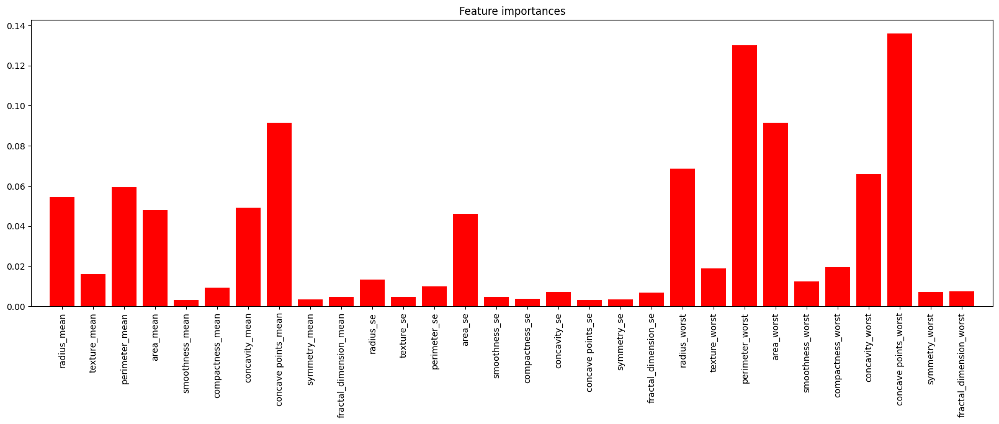

In [16]:
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import joblib
import os
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

df = pd.read_csv("data.csv")
df.drop(df.columns[[0,-1]], axis=1, inplace=True)

# Split the features data and the target
X = df.drop(['diagnosis'], axis=1)
y = df['diagnosis']

# Encoding the target value
y = np.asarray([1 if c == 'M' else 0 for c in y])
# cols = ['concave points_mean','area_mean','radius_mean','perimeter_mean','concavity_mean']
cols = X.columns
# X = df[cols]
print(X.columns)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=43)
print('Shape training set: X:{}, y:{}'.format(X_train.shape, y_train.shape))
print('Shape test set: X:{}, y:{}'.format(X_test.shape, y_test.shape))


rfc = RandomForestClassifier()
rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)
print('Accuracy : {}'.format(accuracy_score(y_test, y_pred)))

clf_report = classification_report(y_test, y_pred)
print('Classification report')
print("---------------------")
print(clf_report)
print("_____________________")

# Print the name and gini importance of each feature
importance = {}
for feature in zip(cols, rfc.feature_importances_):
    # print(feature)
    importance[feature[0]] = feature[1]

# importance.sort()

for feature in importance:
    print(feature,importance[feature])

# Plot the feature importances of the forest
plt.figure(figsize=(20,6))
plt.title("Feature importances")
plt.bar(range(X_train.shape[1]), rfc.feature_importances_, color="r", align="center")
plt.xticks(range(X_train.shape[1]), cols, rotation=90)
plt.xlim([-1, X_train.shape[1]])
plt.show()

# joblib.dump(rfc,"cancer_model.pkl")

In [41]:
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import joblib
import os
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

df = pd.read_csv("data.csv")
df.drop(df.columns[[0,-1]], axis=1, inplace=True)

# Split the features data and the target
X = df.drop(['diagnosis'], axis=1)
y = df['diagnosis']

# Encoding the target value
y = np.asarray([1 if c == 'M' else 0 for c in y])
# cols = ['concave points_mean','area_mean','radius_mean','perimeter_mean','concavity_mean']
cols = X.columns
# X = df[cols]
print(X.columns)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25,random_state=43)
print('Shape training set: X:{}, y:{}'.format(X_train.shape, y_train.shape))
print('Shape test set: X:{}, y:{}'.format(X_test.shape, y_test.shape))


rfc = RandomForestClassifier()
rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)
print('Accuracy : {}'.format(accuracy_score(y_test, y_pred)))

Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')
Shape training set: X:(426, 30), y:(426,)
Shape test set: X:(143, 30), y:(143,)
Accuracy : 0.993006993006993


In [31]:
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import joblib
import os
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

df = pd.read_csv("data.csv")
df.drop(df.columns[[0,-1]], axis=1, inplace=True)

# Split the features data and the target
X = df.drop(['diagnosis'], axis=1)
y = df['diagnosis']

# Encoding the target value
y = np.asarray([1 if c == 'M' else 0 for c in y])
# cols = ['concave points_mean','area_mean','radius_mean','perimeter_mean','concavity_mean']
cols = X.columns
# X = df[cols]
print(X.columns)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=43)
print('Shape training set: X:{}, y:{}'.format(X_train.shape, y_train.shape))
print('Shape test set: X:{}, y:{}'.format(X_test.shape, y_test.shape))


rfc = RandomForestClassifier()
rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)
print('Accuracy : {}'.format(accuracy_score(y_test, y_pred)))

clf_report = classification_report(y_test, y_pred)
print('Classification report')
print("---------------------")
print(clf_report)
print("_____________________")

# Plot the dependency of the accuracy on the number of trees
import matplotlib.pyplot as plt
from sklearn.model_selection import validation_curve
param_range = np.arange(1, 250, 2)
train_scores, test_scores = validation_curve(
    RandomForestClassifier(), X, y, param_name="n_estimators", param_range=param_range,
    cv=3, scoring="accuracy", n_jobs=1)
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)
plt.title("Validation Curve with Random Forest")
plt.xlabel("Number of trees")
plt.ylabel("Score")
plt.ylim(0.0, 1.1)
lw = 2
plt.plot(param_range, train_mean, label="Training score",
                color="darkorange", lw=lw)
plt.fill_between(param_range, train_mean - train_std,
                train_mean + train_std, alpha=0.2,
                color="darkorange", lw=lw)
plt.plot(param_range, test_mean, label="Cross-validation score",
                color="navy", lw=lw)
plt.fill_between(param_range, test_mean - test_std,
                test_mean + test_std, alpha=0.2,
                color="navy", lw=lw)
plt.legend(loc="best")
plt.show()

Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')
Shape training set: X:(398, 30), y:(398,)
Shape test set: X:(171, 30), y:(171,)
Accuracy : 0.9766081871345029
Classification report
---------------------
              precision    recall  f1-score   support

           0       0.98      0.98      0.98       114
           1       0.96      0.96      0.96        57

    accuracy                           0.98       1

KeyboardInterrupt: 

In [18]:
# joblib.dump(rfc,"breast_cancer_model.pkl")

['breast_cancer_model.pkl']

In [42]:
# pickle.dump(rfc, open('final_model.sav', 'wb'))

In [43]:
pickle_in = open('final_model.sav', 'rb')
classifier = pickle.load(pickle_in)

In [49]:
df = pd.read_csv("data.csv")
df.drop(df.columns[[0,1, -1]], axis=1, inplace=True)
df

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [51]:
classifier.predict(df.iloc[:1])

array([1])

Index(['concave points_mean', 'area_mean', 'radius_mean', 'perimeter_mean',
       'concavity_mean'],
      dtype='object')
Shape training set: X:(398, 5), y:(398,)
Shape test set: X:(171, 5), y:(171,)
Accuracy : 0.9473684210526315
Classification report
---------------------
              precision    recall  f1-score   support

           0       0.97      0.95      0.96       114
           1       0.90      0.95      0.92        57

    accuracy                           0.95       171
   macro avg       0.94      0.95      0.94       171
weighted avg       0.95      0.95      0.95       171

_____________________
('concave points_mean', 0.3762003698935534)
('area_mean', 0.18032315557129366)
('radius_mean', 0.1070871483824034)
('perimeter_mean', 0.14041500719963257)
('concavity_mean', 0.19597431895311693)


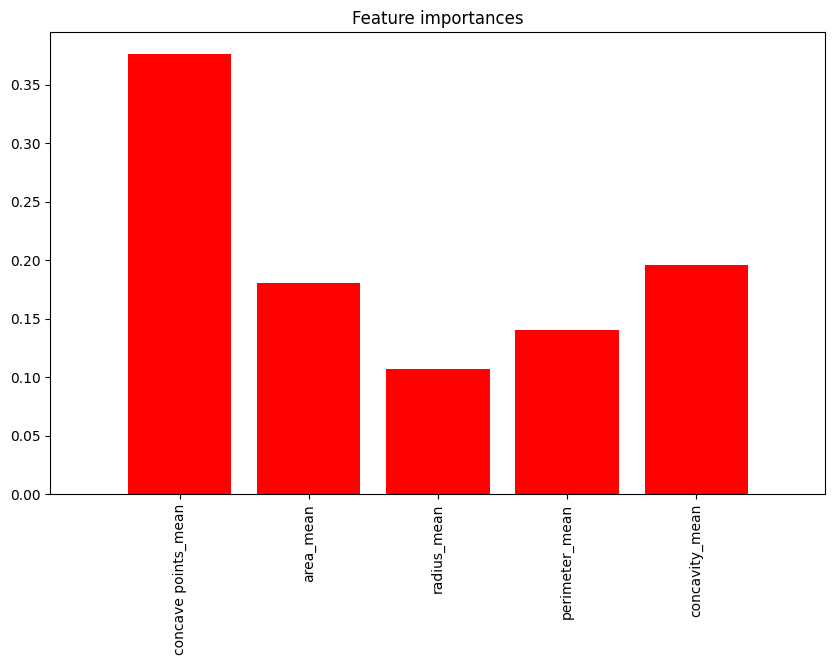

In [7]:
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import joblib
import os
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

df = pd.read_csv("data.csv")
df.drop(df.columns[[0,-1]], axis=1, inplace=True)

# Split the features data and the target
X = df.drop(['diagnosis'], axis=1)
y = df['diagnosis']

# Encoding the target value
y = np.asarray([1 if c == 'M' else 0 for c in y])
cols = ['concave points_mean','area_mean','radius_mean','perimeter_mean','concavity_mean']
X = df[cols]
print(X.columns)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=43)
print('Shape training set: X:{}, y:{}'.format(X_train.shape, y_train.shape))
print('Shape test set: X:{}, y:{}'.format(X_test.shape, y_test.shape))


rfc = RandomForestClassifier()
rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)
print('Accuracy : {}'.format(accuracy_score(y_test, y_pred)))

clf_report = classification_report(y_test, y_pred)
print('Classification report')
print("---------------------")
print(clf_report)
print("_____________________")

# Print the name and gini importance of each feature
for feature in zip(cols, rfc.feature_importances_):
    print(feature)

# Plot the feature importances of the forest
plt.figure(figsize=(10,6))
plt.title("Feature importances")
plt.bar(range(X_train.shape[1]), rfc.feature_importances_, color="r", align="center")
plt.xticks(range(X_train.shape[1]), cols, rotation=90)
plt.xlim([-1, X_train.shape[1]])
plt.show()

# joblib.dump(rfc,"cancer_model.pkl")

([0, 1, 2, 3],
 [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

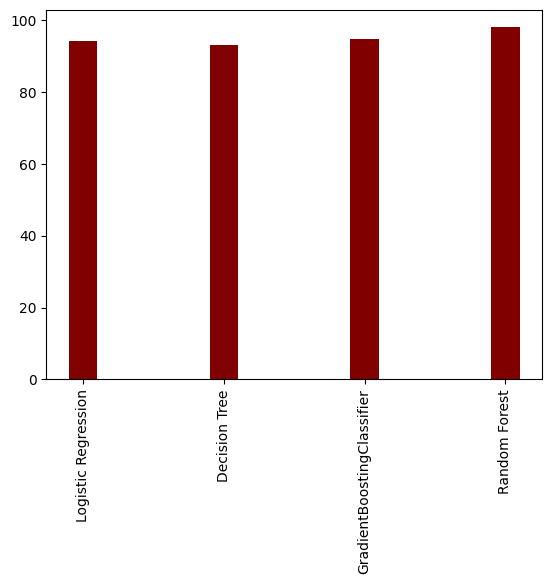

In [35]:

import  matplotlib.pyplot  as  plt
name = ["Logistic Regression", "Decision Tree", "GradientBoostingClassifier", "Random Forest"]
accuracy = [94.15, 92.98,  94.7,98]
# plt.figure(figsize=(20,10))
plt.bar(name, accuracy, color ='maroon', width = 0.2)
plt.xticks(rotation=90)